<a href="https://colab.research.google.com/github/yuchanmo/yuchanmo.github.io/blob/gh-pages/dlib_detectiontest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [19]:
!git clone https://github.com/ageitgey/face_recognition.git  
!apt-get install build-essential cmake
!apt-get install libopenblas-dev liblapack-dev 
!pip3 install dlib
!pip3 install face_recognition
!pip3 install opencv-contrib-python

Cloning into 'face_recognition'...
remote: Enumerating objects: 942, done.
remote: Total 942 (delta 0), reused 0 (delta 0), pack-reused 942
Receiving objects: 100% (942/942), 101.48 MiB | 23.66 MiB/s, done.
Resolving deltas: 100% (550/550), done.
Reading package lists... Done
Building dependency tree       
Reading state information... Done
build-essential is already the newest version (12.4ubuntu1).
cmake is already the newest version (3.10.2-1ubuntu2.18.04.1).
0 upgraded, 0 newly installed, 0 to remove and 17 not upgraded.
Reading package lists... Done
Building dependency tree       
Reading state information... Done
liblapack-dev is already the newest version (3.7.1-4ubuntu1).
libopenblas-dev is already the newest version (0.2.20+ds-4).
0 upgraded, 0 newly installed, 0 to remove and 17 not upgraded.


In [10]:
import os
filelist = list(filter(lambda x : 'jpg' in x ,os.listdir()))

In [11]:
filelist

['a.jpg',
 'KakaoTalk_20210127_225601184.jpg',
 'KakaoTalk_20210127_225601184_02.jpg',
 'KakaoTalk_20210127_225601184_04.jpg',
 'KakaoTalk_20210127_231011056.jpg',
 'KakaoTalk_20210127_225601184_03.jpg',
 'KakaoTalk_20210127_225604833_01.jpg',
 'KakaoTalk_20210127_231145076.jpg',
 'KakaoTalk_20210127_225601184_05.jpg',
 'b.jpg',
 'KakaoTalk_20210127_231145076_02.jpg',
 'KakaoTalk_20210127_225601184_01.jpg',
 'KakaoTalk_20210127_231145076_01.jpg',
 'KakaoTalk_20210127_231145076_03.jpg',
 'KakaoTalk_20210127_230851686.jpg']

In [25]:
import cv2
imglist = [cv2.imread(f) for f in filelist ]

In [13]:
from google.colab.patches import cv2_imshow

In [53]:
from matplotlib import pyplot as plt
import matplotlib.pyplot as plt
import dlib
%matplotlib inline
detector = dlib.get_frontal_face_detector()
predictor= dlib.shape_predictor(r'/content/shape_predictor_68_face_landmarks.dat')
def drawrect(image):
  img_tmp = image.copy()
  face_locations = detector(img_tmp)
  for faceRect in face_locations:
    x1 = faceRect.left()
    y1 = faceRect.top()
    x2 = faceRect.right()
    y2 = faceRect.bottom()
    cv2.rectangle(img_tmp,(x1,y1),(x2,y2),(0,0,255),5)
    shape = predictor(img_tmp, faceRect)
    for j in range(shape.num_parts):
        x, y = shape.part(j).x, shape.part(j).y
        cv2.circle(img_tmp, (x, y), 1, (255, 255, 255),4)
  cv2_imshow(img_tmp)
  return img_tmp


In [31]:
#LANDMARK 관련
!wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
!bzip2 -d /content/shape_predictor_68_face_landmarks.dat.bz2

--2021-02-16 04:57:45--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘shape_predictor_68_face_landmarks.dat.bz2.1’

shape_predictor_68_ 100%[===================>]  61.07M  6.01MB/s    in 34s     

2021-02-16 04:58:20 (1.77 MB/s) - ‘shape_predictor_68_face_landmarks.dat.bz2.1’ saved [64040097/64040097]



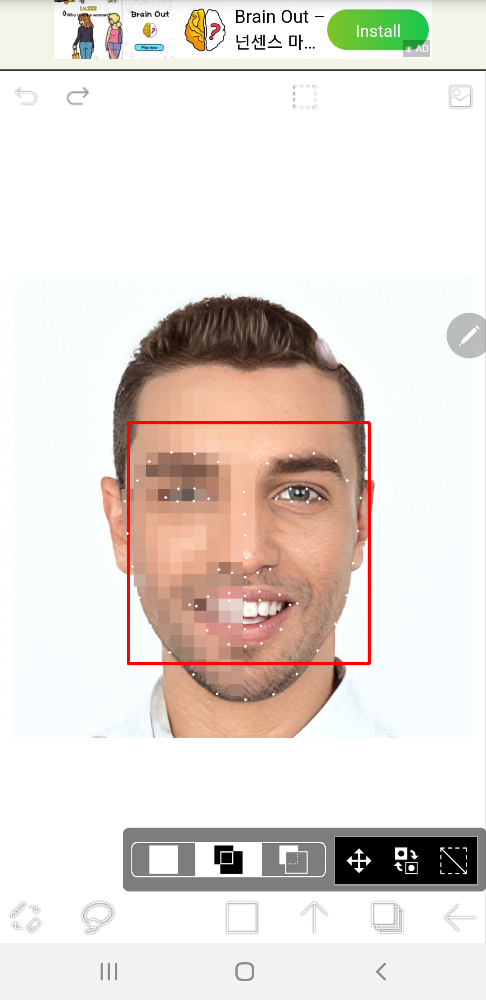

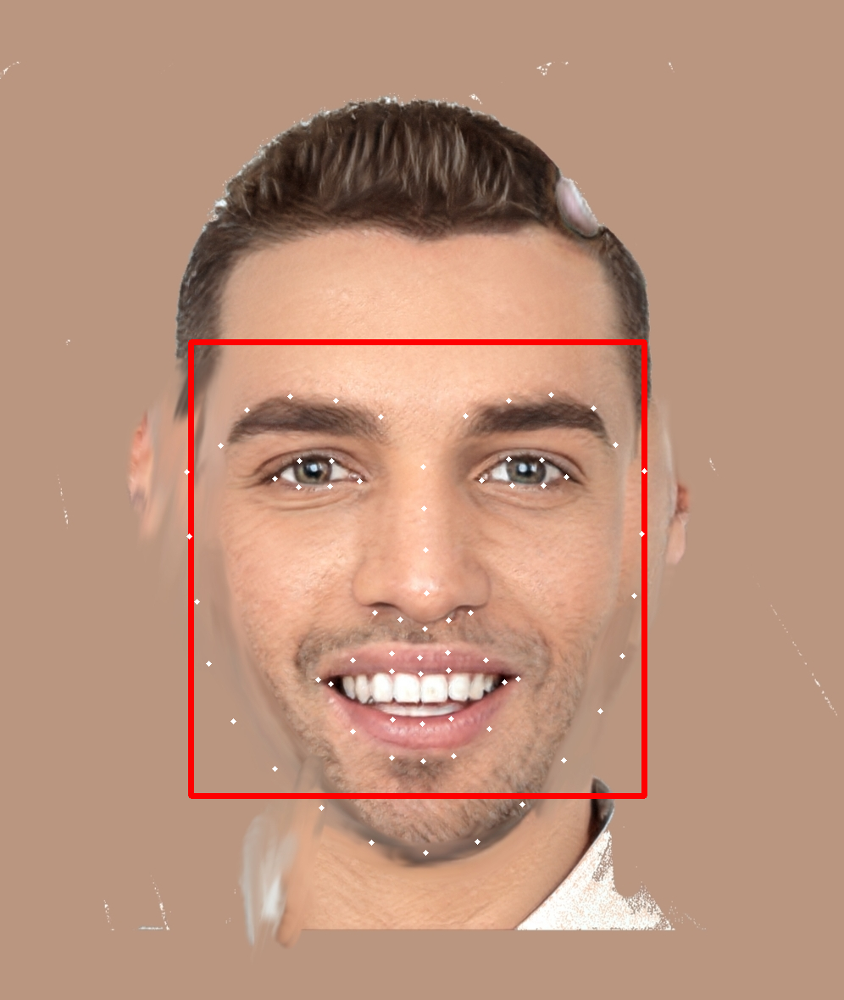

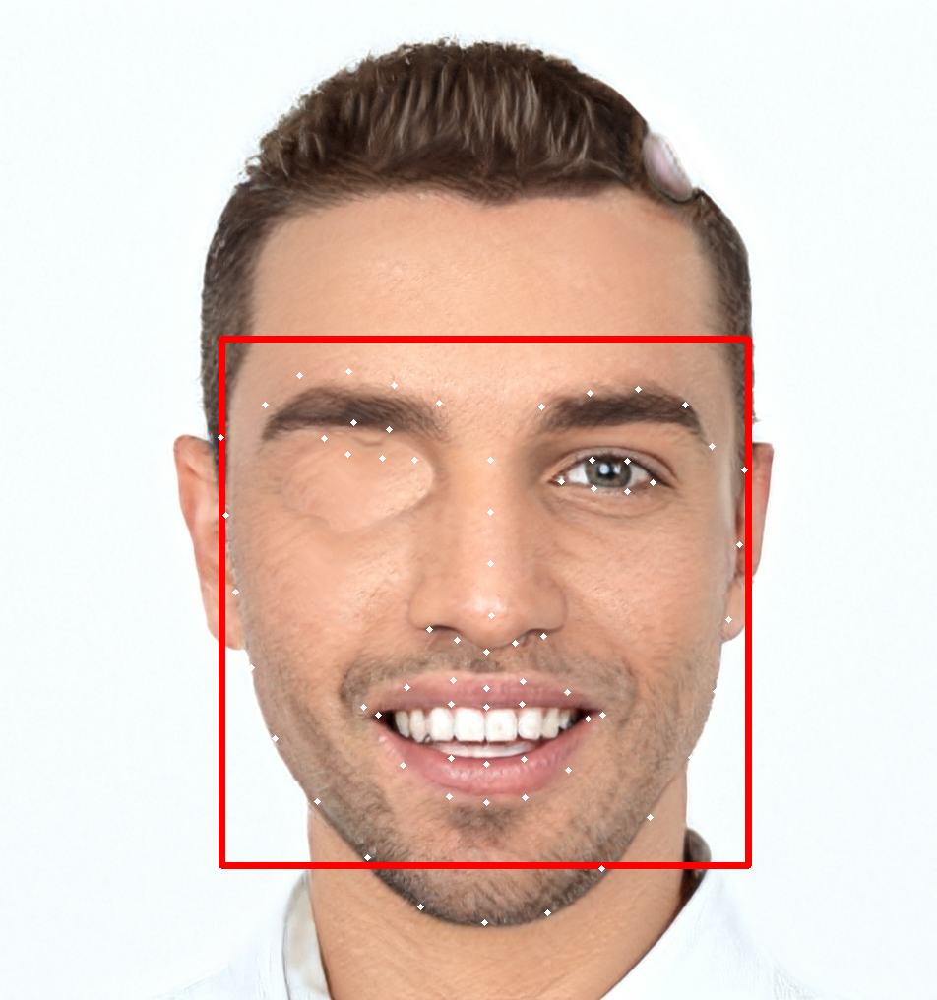

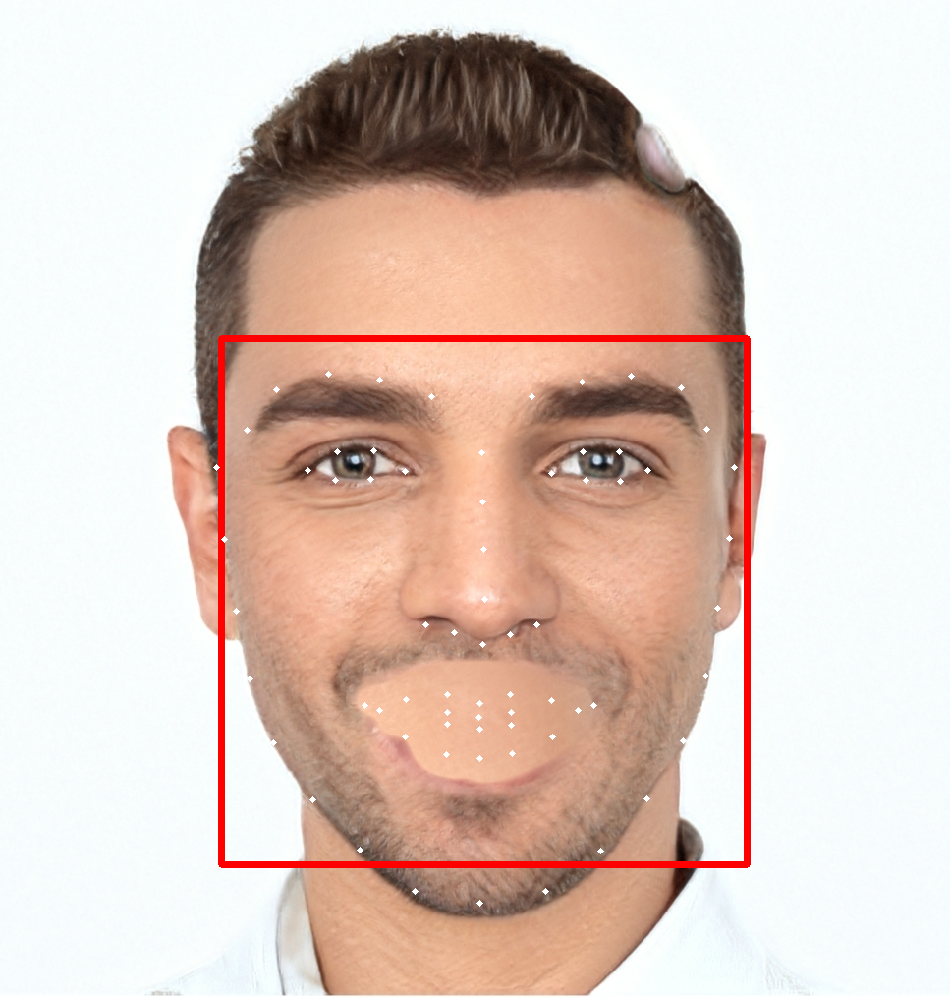

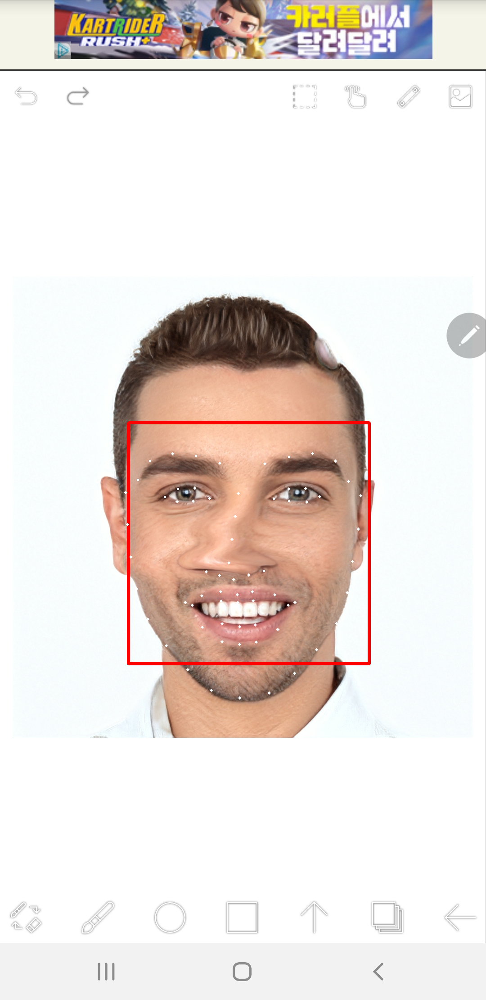

...

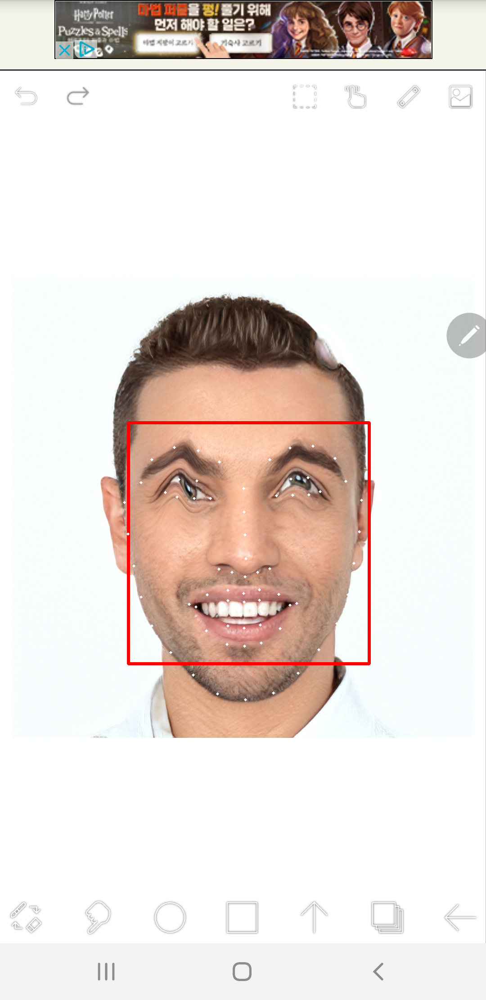

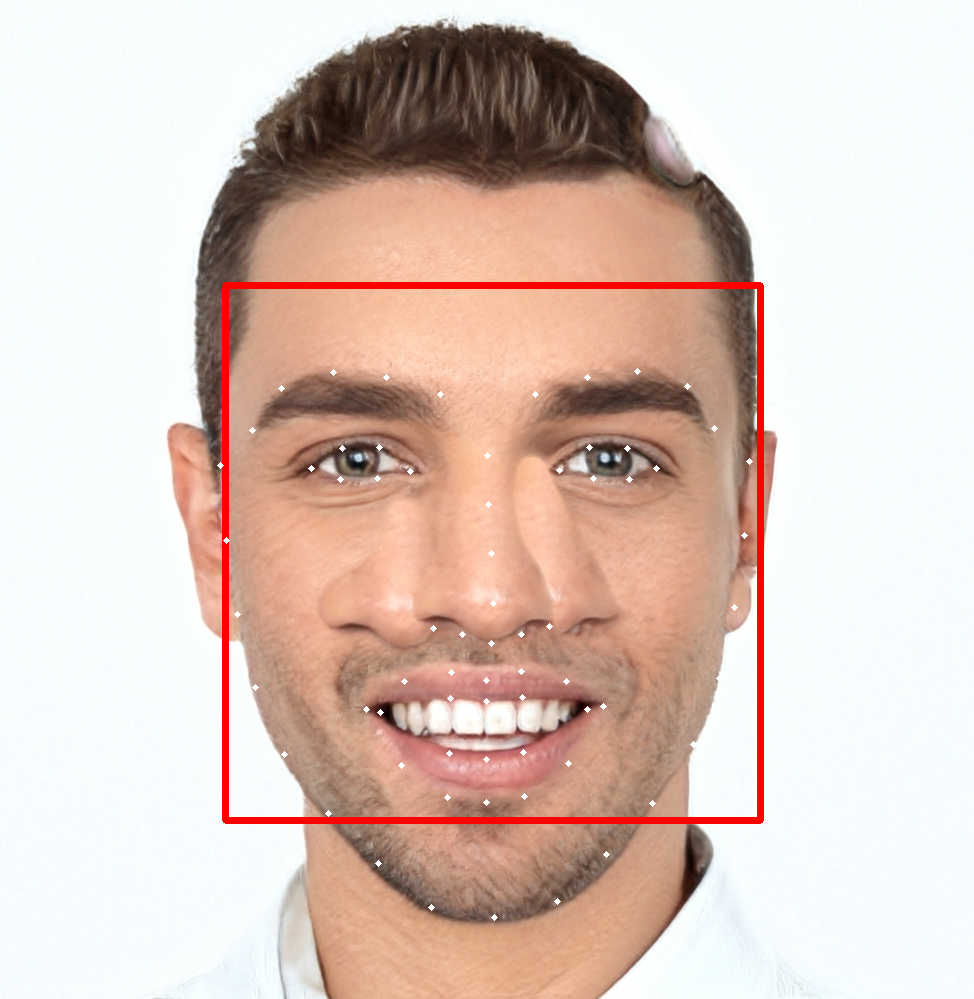

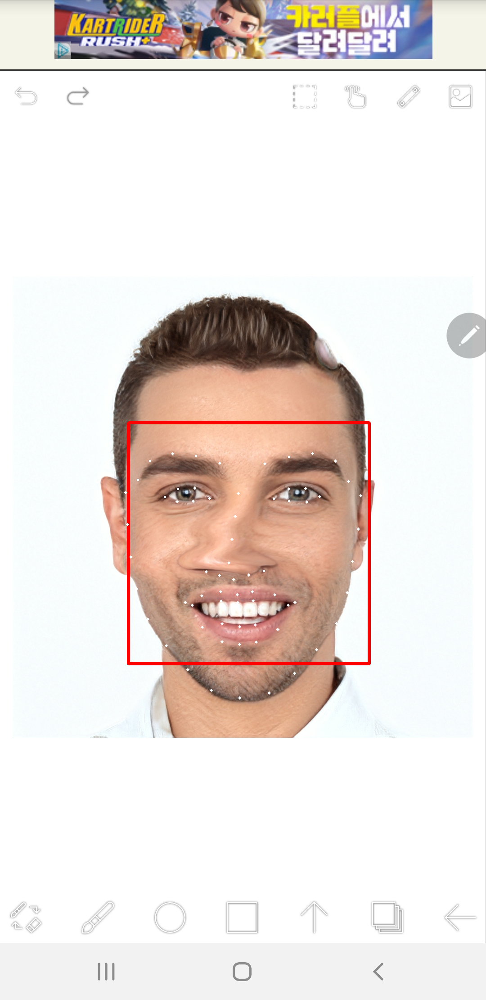

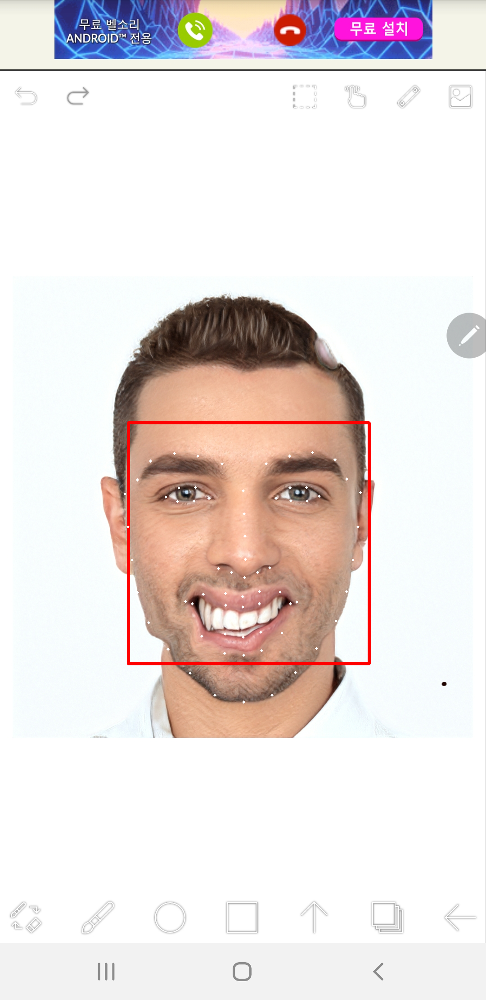

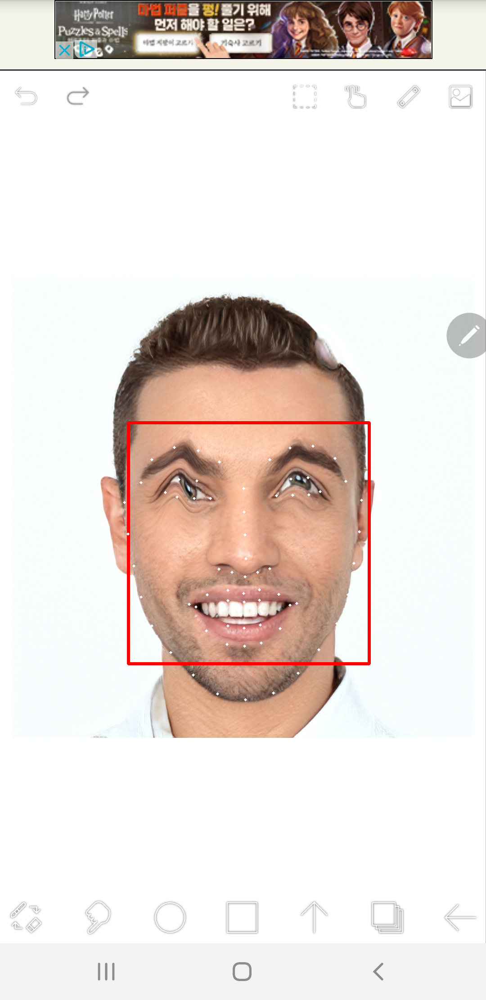

In [54]:
for i in imglist:
  drawrect(i)

In [37]:
s = imglist[0]

In [41]:
rect = detector(s,1)

In [48]:
predictor(s,rect[0]).num_parts

68

In [ ]:
sh